In [276]:
# general 
import pandas as pd 
import numpy as np 
from datetime import datetime
import itertools
import sktime
import math
import pprint

# stats
from scipy import stats
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tools.eval_measures import rmse, aic
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.vector_ar.vecm import coint_johansen
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.varmax import VARMAX

# plotting
import seaborn as sns 
import plotly.express as px
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from pandas.plotting import autocorrelation_plot

# settings
plt.style.use('seaborn')
plt.rcParams["figure.figsize"] = (16, 8)
pd.options.plotting.backend = "plotly"

# ML
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [277]:
hrv_file = "04-12-21-HRV-Data-Postprocess-Kubios.csv"
cgm_file = "04-12-21-CGM-Data.csv"

## HRV Analysis
The daily HRV file from 04/12/21 is provided here and prepared for analysis. Note that unlike the CGM values which are of 24 hour, HRV is only collected as per:

- 5 minutes before breakfast
- 2 hours post dinner

In most cases, the timings for collection will vary. In this case, collection was started at 0731 hours and concluded at 2209 hours.

In [278]:
# parse HRV file  
df = pd.read_csv(hrv_file,
                     parse_dates={'date-time' : ['time', "date"]},
                     index_col='date-time'
                     )

df.drop(['seconds'], axis=1, inplace=True)
df

,rr
date-time,
2021-12-04 07:31:37,855
2021-12-04 07:31:38,855
2021-12-04 07:31:39,862
2021-12-04 07:31:40,890
2021-12-04 07:31:41,950
...,...
2021-12-04 22:09:13,1185
2021-12-04 22:09:15,1239
2021-12-04 22:09:16,1275


##### Observation
Because HRV data is the beat to beat interval, some portions are >1 sec. This means that from 7.31.37am to 22.09.18pm, there are more than 52661 seconds (14 hours converted to seconds).

Here, 66996 rows are observed. We proceed to resample it to fit 52661 seconds.

In [279]:
# resample into 1 sec intervals, pad in between values
df = df.resample('1s').median()

# some NaN values are observed. check for and replace NaN values
df['rr'].isnull().sum()

# interpolate between readings
df.interpolate(method='linear', inplace=True)

In [280]:
fig = px.line(
    df,
    x=df.index,
    y="rr"
)
fig.show()

### HRV Metrics (RMSSD, SDNN, etc)
R-R peaks are now transformed into N-N (normal to normal) peaks after ectopic/outlier beat removal and interpolation. Here, we obtain time and frequency features from our data in a 5 minute block.

A python library: hrv-analysis (https://pypi.org/project/hrv-analysis/) is used.

In [282]:
# time domain features are computed on a 5 minute window
from hrvanalysis import get_time_domain_features

# frequency domain features computed on 5 minute window
from hrvanalysis import get_frequency_domain_features

In [283]:
df = df.iloc[
        df.index.get_loc('2021-12-04 10:30:00'):df.index.get_loc('2021-12-04 14:30:00')
    ]
df.info

<bound method DataFrame.info of                               rr
date-time                       
2021-12-04 10:30:00   965.000000
2021-12-04 10:30:01   921.666667
2021-12-04 10:30:02   878.333333
2021-12-04 10:30:03   835.000000
2021-12-04 10:30:04   694.000000
...                          ...
2021-12-04 14:29:55  1153.000000
2021-12-04 14:29:56  1084.000000
2021-12-04 14:29:57  1187.000000
2021-12-04 14:29:58  1033.000000
2021-12-04 14:29:59   904.000000

[14400 rows x 1 columns]>

Rolling window idea from:
> https://stackoverflow.com/questions/66342868/how-to-apply-a-function-not-returning-a-numeric-value-to-a-pandas-rolling-window

also helpful:
>https://stackoverflow.com/questions/6822725/rolling-or-sliding-window-iterator

In [284]:
# create rolling arrays of 600 values (5 min)
def rolling_window(data_in_series, timescale):
    lst = [_ for _ in list(data_in_series.rolling(timescale))]
    return pd.Series(lst, index=data_in_series.index)

new_series = rolling_window(df['rr'], '5T')

In [285]:
# drop first x minutes so that our window size is constant
WINDOW_OFFSET_IN_SECONDS = 300
new_series = new_series[WINDOW_OFFSET_IN_SECONDS:]

In [286]:
# calculate time and frequency domain params for all arrays
def generate_time_features(data):
    return pd.DataFrame(
        [get_time_domain_features(_.tolist()) for _ in new_series], \
            index=data.index
            )
    
time_df = generate_time_features(new_series)

In [287]:
time_df.plot()

In [288]:
# calculate time and frequency domain params for all arrays
def generate_freq_features(data):
    return pd.DataFrame(
        [get_frequency_domain_features(_.tolist()) for _ in new_series], \
            index=data.index
            )
    
freq_df = generate_freq_features(new_series)

In [289]:
freq_df.plot()

In [290]:
# merge both time and freq to create a combined dataframe
all_df = pd.merge(time_df, freq_df, on=time_df.index).set_index(time_df.index)
all_df.drop(labels="key_0", axis=1, inplace=True)

## CGM Analysis
The daily CGM file from the 04/12/21 is provided here and prepared for analysis.

In [291]:
df = pd.read_csv(
    cgm_file,
    parse_dates={'date-time': ['date','time']},
    index_col ="date-time"
)

df.drop(['device', 'serial number'], axis=1, inplace=True)

In [292]:
# upsample into 5 min intervals from 15min CGM values, take median
df = df.resample('5T').median()

# some NaN values are observed. check for and replace NaN values
print(df['glucose'].isnull().sum())

# interpolate between readings
df.interpolate(method='linear', inplace=True)

191


In [293]:
df.plot()

In [294]:
# appears that CGM data does not follow a gaussian distribution
fig = px.histogram(df, x=df['glucose'])
fig.show()

HRV starts from 27097 seconds (7.31am). CGM data starts from 12am. 

Create 2 dataframes, merging them on the time index with an inner join.

1. Glucose and time domain HRV features
2. Glucose and frequency domain HRV features\

In [296]:
time_glucose_df = pd.merge(left=df, right=time_df, left_index=True, right_index=True, how='inner')
freq_glucose_df = pd.merge(left=df, right=freq_df, left_index=True, right_index=True, how='inner')

In [297]:
time_glucose_df.shape

(47, 17)

### Augmented Dickey-Fuller Test (ADF Test)

ADF test is used to test for stationarity of a time-series. A stationary time series does not have trends or seasonal effects. Examine if CGM univariate time series is stationary.

- Null hypothesis: TS has a unit root (non stationary)
- Alternate hypothesis: TS does **NOT** have a unit root (stationary)

In [298]:
def adfuller_test(series, signif=0.05, name='', verbose=False):
    """Perform ADFuller to test for Stationarity of given series and print report"""
    r = adfuller(series, autolag='AIC')
    output = {'test_statistic':round(r[0], 4), 'pvalue':round(r[1], 4), 'n_lags':round(r[2], 4), 'n_obs':r[3]}
    p_value = output['pvalue'] 
    def adjust(val, length= 6): return str(val).ljust(length)

    # Print Summary
    print(f'    Augmented Dickey-Fuller Test on "{name}"', "\n   ", '-'*47)
    print(f' Null Hypothesis: Data has unit root. Non-Stationary.')
    print(f' Significance Level    = {signif}')
    print(f' Test Statistic        = {output["test_statistic"]}')
    print(f' No. Lags Chosen       = {output["n_lags"]}')

    for key,val in r[4].items():
        print(f' Critical value {adjust(key)} = {round(val, 3)}')

    if p_value <= signif:
        print(f" => P-Value = {p_value}. Rejecting Null Hypothesis.")
        print(f" => Series is Stationary.")
    else:
        print(f" => P-Value = {p_value}. Weak evidence to reject the Null Hypothesis.")
        print(f" => Series is Non-Stationary.")

In [299]:
# run augmented dickey-fuller test on all columns to detect stationarity
def adf_harness(data):
    for colname, colvalues in data.iteritems():
        adfuller_test(colvalues, name=colname)
        print("\n")
         
adf_harness(time_glucose_df)

    Augmented Dickey-Fuller Test on "glucose" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -1.7175
 No. Lags Chosen       = 7
 Critical value 1%     = -3.61
 Critical value 5%     = -2.939
 Critical value 10%    = -2.608
 => P-Value = 0.4221. Weak evidence to reject the Null Hypothesis.
 => Series is Non-Stationary.


    Augmented Dickey-Fuller Test on "mean_nni" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -3.1864
 No. Lags Chosen       = 1
 Critical value 1%     = -3.585
 Critical value 5%     = -2.928
 Critical value 10%    = -2.602
 => P-Value = 0.0208. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "sdnn" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationa

In [ ]:
# install sktime if not installed
# !pip install sktime

In [300]:
from sktime.forecasting.model_selection import temporal_train_test_split

# 25% of the dataset will be used for testing
y_train, y_test = temporal_train_test_split(time_glucose_df, test_size=0.25)

print(f"Training set shape: {y_train.shape}")
print(f"Test set shape: {y_test.shape}")

Training set shape: (35, 17)
Test set shape: (12, 17)


In [338]:
# taking log of the dataset and first order differentiating the data
y_train_log_diff = np.log(y_train).diff(periods=1).dropna()
y_train_log_diff.describe()

,glucose,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,median_nni,range_nni,cvsd,cvnni,mean_hr,max_hr,min_hr,std_hr
count,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000,34.000000
mean,0.008674,0.005375,0.006917,-0.008415,-0.015024,-0.015024,0.005902,0.005902,-0.008421,0.005318,0.004018,-0.013796,0.001542,-0.005355,-0.007588,-0.006124,-0.004235
std,0.045569,0.098058,0.343073,0.238092,0.778467,0.778467,0.201605,0.201605,0.238119,0.118286,0.237563,0.212235,0.321244,0.097177,0.114790,0.086224,0.340923
min,-0.078472,-0.181430,-0.613360,-0.726851,-3.198673,-3.198673,-0.782378,-0.782378,-0.726902,-0.229301,-0.454534,-0.613074,-0.706578,-0.213700,-0.229533,-0.238575,-0.746404
25%,-0.023856,-0.054299,-0.201326,-0.155353,-0.231555,-0.231555,-0.084442,-0.084442,-0.155307,-0.065977,-0.172927,-0.124409,-0.223523,-0.069822,-0.076809,-0.032492,-0.256130
50%,0.003413,-0.002445,-0.011948,-0.025343,-0.007299,-0.007299,0.005556,0.005556,-0.025391,-0.009506,-0.013711,-0.031508,-0.052770,0.011578,-0.033344,-0.000469,-0.078281
75%,0.040117,0.062595,0.254925,0.116511,0.258151,0.258151,0.105762,0.105762,0.116306,0.065845,0.166257,0.110589,0.251786,0.056236,0.069168,0.028233,0.285760
max,0.087459,0.232247,0.800639,0.547342,2.442347,2.442347,0.287682,0.287682,0.547441,0.283391,0.445585,0.418660,0.568392,0.174466,0.287258,0.194488,0.650587


In [339]:
# run another adf test to confirm stationarity
adf_harness(y_train_log_diff)

    Augmented Dickey-Fuller Test on "glucose" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -1.0682
 No. Lags Chosen       = 6
 Critical value 1%     = -3.7
 Critical value 5%     = -2.976
 Critical value 10%    = -2.628
 => P-Value = 0.7276. Weak evidence to reject the Null Hypothesis.
 => Series is Non-Stationary.


    Augmented Dickey-Fuller Test on "mean_nni" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -5.2222
 No. Lags Chosen       = 0
 Critical value 1%     = -3.646
 Critical value 5%     = -2.954
 Critical value 10%    = -2.616
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "sdnn" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.


In [237]:
y_train_log_diff.plot()

In [240]:
# dropping non stationary time domain metrics
y_train_log_diff.drop(labels=['mean_nni', 'median_nni', 'mean_hr', 'max_hr'],
                      axis=1,
                      inplace=True)

#### Interpreting time series correlation
Refer to:
>https://stats.stackexchange.com/questions/133155/how-to-use-pearson-correlation-correctly-with-time-series

Check out the bi-directional relationship between the independent variables and the dependent variables. Some other causuality tests can be tried, i.e. Granger Causality Test to investigate causality between two time series variables.

Granger casuality testing only applies to differentiated intervals, i.e. they must be stationary.

- Null hypothesis: HRV feature (x) does not explain variation in (y) glucose.
- Alternative hypothesis: HRV feature (x) has an effect on glucose with a 95% confidence interval that a change in x causes a response in 'glucose' (y)

In [256]:
# running a chi^2 test on each series of the final df
test = 'ssr_chi2test'

def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False, maxlag=12):    
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

In [260]:
grangers_causation_matrix(y_train_log_diff, variables=y_train_log_diff.columns, maxlag=3)

,glucose_x,sdnn_x,sdsd_x,nni_50_x,pnni_50_x,nni_20_x,pnni_20_x,rmssd_x,range_nni_x,cvsd_x,cvnni_x,min_hr_x,std_hr_x
glucose_y,1.0000,0.0000,0.0000,0.0002,0.0002,0.0000,0.0000,0.0000,0.0000,0.0006,0.0000,0.0000,0.0000
sdnn_y,0.0039,1.0000,0.2080,0.5454,0.5454,0.2958,0.2958,0.2082,0.0103,0.0465,0.0552,0.1323,0.0372
sdsd_y,0.0006,0.0290,1.0000,0.0183,0.0183,0.1039,0.1039,0.0012,0.2724,0.0002,0.0539,0.2247,0.1267
nni_50_y,0.0217,0.0742,0.0216,1.0000,1.0000,0.1211,0.1211,0.0218,0.1691,0.0964,0.1101,0.3188,0.2383
pnni_50_y,0.0217,0.0742,0.0216,1.0000,1.0000,0.1211,0.1211,0.0218,0.1691,0.0964,0.1101,0.3188,0.2383
nni_20_y,0.0021,0.0012,0.0737,0.0046,0.0046,1.0000,1.0000,0.0738,0.0388,0.0216,0.0028,0.0570,0.0259
pnni_20_y,0.0021,0.0012,0.0737,0.0046,0.0046,1.0000,1.0000,0.0738,0.0388,0.0216,0.0028,0.0570,0.0259
rmssd_y,0.0006,0.0291,0.0012,0.0185,0.0185,0.1042,0.1042,1.0000,0.2724,0.0002,0.0540,0.2248,0.1268
range_nni_y,0.0063,0.0037,0.2284,0.9217,0.9217,0.6769,0.6769,0.2287,1.0000,0.7955,0.3177,0.0262,0.1122
cvsd_y,0.0010,0.0648,0.0041,0.1224,0.1224,0.0236,0.0236,0.0040,0.5016,1.0000,0.0700,0.3147,0.2413


In [275]:
model = VAR(y_train_log_diff)
for i in [_ for _ in range(10)]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

C:\Users\itsda\miniconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 5T will be used.



Lag Order = 0


LinAlgError: 7-th leading minor of the array is not positive definite

In [271]:
# using a VAR model to determine lag order values
# model = VAR(endog=y_train_log_diff[['glucose', 'rmssd']])
# res = model.select_order(5)
# res.summary()

### Persistence Algorithm
As a prediction baseline, this is the __naive__ forecast.

This uses the values at the current time step, (t) to predict the value at the next time step (t+1). This baseline prediction will then be compared with other models that can be explored later.

In [69]:
# Create lagged dataset
values = pd.DataFrame(df.values)
dataframe = pd.concat([values.shift(1), values], axis=1)
dataframe.columns = [' t' , ' t+1' ]
print(dataframe.head(5))

          t       t+1
0       NaN  5.400000
1  5.400000  5.366667
2  5.366667  5.333333
3  5.333333  5.300000
4  5.300000  5.233333


In [24]:
# split into train and test sets
X = dataframe.values
train_size = int(len(X) * 0.66)
train, test = X[1:train_size], X[train_size:]
train_X, train_y = train[:,0], train[:,1]
test_X, test_y = test[:,0], test[:,1]

In [25]:
# baseline model
res = lambda x : x

# walk-forward validation
predictions = []
for x in test_X:
    yhat = res(x)
    predictions.append(yhat)
    
# calculate baseline prediction
rmse = math.sqrt(mean_squared_error(test_y, predictions))
print(' Test RMSE: %.3f' % rmse)

 Test RMSE: 0.166


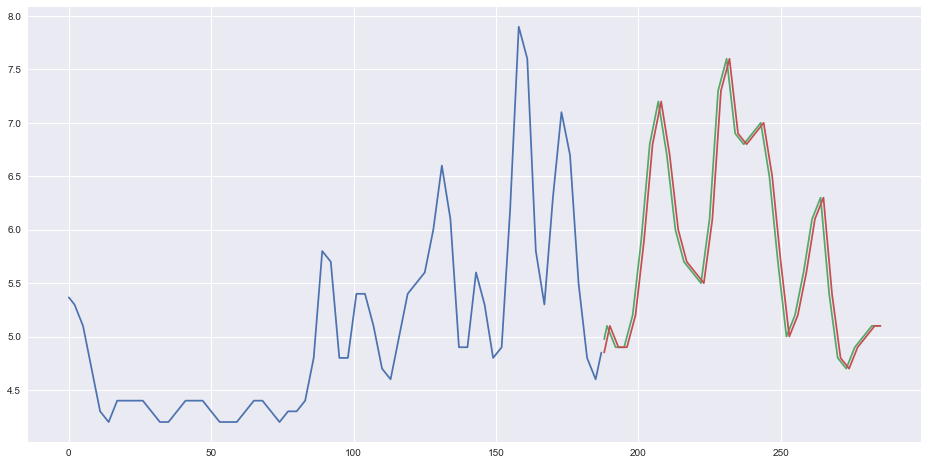

In [26]:
plt.plot(train_y)
plt.plot([None for i in train_y] + [x for x in test_y])
plt.plot([None for i in train_y] + [x for x in predictions])

In [68]:
# split TS into train and test data using walk forward validation
def forecast_params(data, forecast_horizon, steps_to_validate_over):
    return len(data) - forecast_horizon - steps_to_validate_over + 1

Ntest = forecast_params(time_glucose_df, 3, 2)

In [65]:
def walkforward_split(data, model, forecast_horizon, start_index, debug=False):
    '''
    Takes in a model with all fitted params and performs walk forward validation over the forecast horizon
    '''
    # store errors
    errors = []
    seen_last = False
    steps_completed = 0

    for end_of_train in range(start_index, len(data) - h + 1):
        # We don't have to manually "add" the data to our dataset
        # Just index it at the right points - this is a "view" not a "copy"
        # So it doesn't take up any extra space or computation
        train = data.iloc[:end_of_train]
        test = data.iloc[end_of_train:end_of_train + h]
    
    # final row reached
    if test.index[-1] == data.index[-1]:
        seen_last = True
        
    steps_completed += 1
    
    hw = model()
    res_hw = hw.fit()
    
    # compute error for the forecast horizon
    fcast = res_hw.forecast(forecast_horizon)
    error = mean_squared_error(test, fcast)
    errors.append(error)
  
    if debug:
        print("seen_last:", seen_last)
        print("steps completed:", steps_completed)

    return np.mean(errors)

In [ ]:
# Create lagged dataset
def lagged_df_creator(data):
    values = pd.DataFrame(data.values)
    dataframe = pd.concat([values.shift(1), values], axis=1)
    dataframe.columns = [' t' , ' t+1' ]
    
lagged_df = lagged_df_creator(df)

In [ ]:
# perform naive forecast
res = lambda x : x

r = walkforward_split(res, 3, )

# # walk-forward validation
# predictions = []
# for x in test_X:
#     yhat = res(x)
#     predictions.append(yhat)
    
# # calculate baseline prediction
# rmse = math.sqrt(mean_squared_error(test_y, predictions))
# print(' Test RMSE: %.3f' % rmse)

Relevant HRV time domain metrics to consider:
1. median_nni
2. sdsd
3. rmssd
4. mean_hr

Frequency domain metrics to consider:
1. lf_x (low frequency is associated with SNS activity, after all)

## Cointegration test:

To find out how many lagging terms are required for a TS to become stationary.
With two or more TS, they are considered cointegrated if they have a statistically significant relationship.
This means, there exists a linear combination of them that has an order of integration less than that of the individual series.

>https://en.wikipedia.org/wiki/Cointegration

and

>http://www-stat.wharton.upenn.edu/~steele/Courses/434/434Context/Co-integration/Murray93DrunkAndDog.pdf

and

>https://en.m.wikipedia.org/wiki/Johansen_test

and

>https://en.wikipedia.org/wiki/Error_correction_model

- null hypothesis: no cointegrating equations
- alternate hypothesis: at least 1 cointegrating relationship

In [49]:
def cointegration_test_harness(data, alpha=0.05):
    out = coint_johansen(data, -1, 5)
    d = {'0.90':0, '0.95':1, '0.99':2}
    traces = out.lr1
    cvts = out.cvt[:, d[str(1-alpha)]]
    def adjust(val, length= 6): return str(val).ljust(length)

    # Summary
    print('Name   ::  Test Stat > C(95%)    =>   Signif  \n', '--'*20)
    for col, trace, cvt in zip(df.columns, traces, cvts):
        print(adjust(col), ':: ', adjust(round(trace,2), 9), ">", adjust(cvt, 8), ' =>  ' , trace > cvt)

In [58]:
time_glucose_df

,glucose,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,median_nni,range_nni,cvsd,cvnni,mean_hr,max_hr,min_hr,std_hr
date-time,,,,,,,,,,,,,,,,,
2021-12-04 10:35:00,5.733333,717.162500,63.135102,39.420564,35,11.705686,117,39.130435,39.428343,710.25,391.666667,0.054978,0.088035,84.292465,113.207547,65.099458,7.223405
2021-12-04 10:40:00,5.866667,820.853333,110.411498,39.906225,58,19.397993,148,49.498328,39.907360,803.25,546.000000,0.048617,0.134508,74.386530,96.153846,51.282051,9.743168
2021-12-04 10:45:00,6.000000,972.798333,118.092136,61.363567,96,32.107023,195,65.217391,61.369447,951.50,518.000000,0.063085,0.121394,62.566151,76.433121,46.047583,7.384780
2021-12-04 10:50:00,6.200000,896.855000,121.089017,63.763880,100,33.444816,193,64.548495,63.764257,893.00,690.000000,0.071098,0.135015,68.189090,101.867572,46.911650,9.786910
2021-12-04 10:55:00,6.400000,869.430000,124.764548,50.307841,79,26.421405,179,59.866221,50.311770,869.00,529.000000,0.057868,0.143502,70.464162,94.637224,51.590714,10.310156
2021-12-04 11:00:00,6.600000,928.285833,102.379104,42.689127,83,27.759197,181,60.535117,42.691958,927.00,446.000000,0.045990,0.110288,65.438894,85.714286,52.356021,7.357027
2021-12-04 11:05:00,6.433333,825.893333,117.101321,41.053698,61,20.401338,160,53.511706,41.063048,835.00,529.000000,0.049720,0.141787,74.145023,96.930533,52.264808,10.687871
2021-12-04 11:10:00,6.266667,833.368333,95.633263,38.323029,61,20.401338,164,54.849498,38.328692,836.50,421.000000,0.045992,0.114755,72.967212,95.693780,57.251908,8.540088
2021-12-04 11:15:00,6.100000,818.447500,85.579135,37.473698,49,16.387960,164,54.849498,37.475672,818.50,449.000000,0.045789,0.104563,74.117266,95.846645,55.813953,7.806349


In [57]:
k = time_glucose_df[['median_nni', 'sdsd', 'rmssd', 'mean_hr']]
np.linalg.cholesky(k)

LinAlgError: Last 2 dimensions of the array must be square

In [102]:
k = time_glucose_df[['mean_nni', 'sdnn', 'sdsd']]
cointegration_test_harness(k)

Name   ::  Test Stat > C(95%)    =>   Signif  
 ----------------------------------------
glucose ::  44.0      > 24.2761   =>   True


In [29]:
fig = px.line(
    norm,
    x=norm.index,
    y=[norm['glucose'], norm["sdnn"], norm["rmssd"]]
)
fig.show()

In [ ]:
result = adfuller(df['glucose'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')

for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

Since P value > 5% value, CGM data is not stationary. Performing first order differentiation.

In [ ]:
# take difference 
diff = list()
for i in range(1, len(df)):
    value = df['glucose'][i] - df['glucose'][i - 1]
    diff.append(value)
    
diff_df = pd.DataFrame(diff, index=df.index[1:], columns=['differenced-values'])
diff_df.plot()

In [ ]:
autocorrelation_plot(diff_df)